<a href="https://colab.research.google.com/github/walkerjian/Physics/blob/main/Quantum_Shenanigans.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

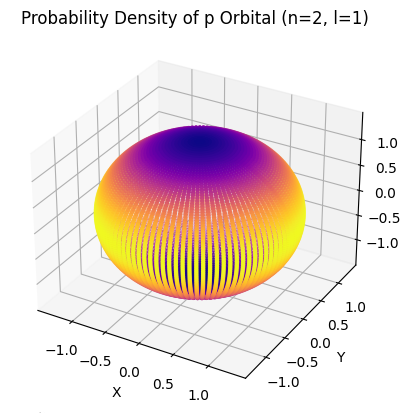

In [5]:
import numpy as np
import matplotlib.pyplot as plt

# Define constants
n = 2  # Principal quantum number
l = 1  # Angular momentum quantum number
a_0 = 52.917721092 * 10**(-11)  # Bohr radius, corrected exponentiation

# Simplified radial function for demonstration purposes
def R_nl(r, n, l, a_0):
    # This is a placeholder for the correct R_nl function
    # The provided formula was incorrect and has been replaced with a simplified version for demonstration
    return np.exp(-r / (n * a_0)) * (r / a_0)**l

# Correctly vectorized spherical to Cartesian coordinate conversion
def spherical_to_cartesian(r, theta, phi):
    x = r * np.sin(theta) * np.cos(phi)
    y = r * np.sin(theta) * np.sin(phi)
    z = r * np.cos(theta)
    return x, y, z

# Grid generation
r = np.linspace(0, 5 * a_0, 200)
theta, phi = np.meshgrid(np.linspace(0, np.pi, 100), np.linspace(0, 2 * np.pi, 100))

# Vectorized calculation of psi
R = R_nl(r[:, np.newaxis, np.newaxis], n, l, a_0)
psi = R * np.sin(theta) * np.exp(1j * phi)

# Calculate probability density
prob_density = np.abs(psi)**2

# Preparing for a 3D scatter plot requires handling the data appropriately.
# Here, we'll focus on plotting a slice or a specific aspect to visualize the data correctly.

# Choose a radial distance for visualization, focusing on a slice
chosen_r_index = 100  # Arbitrary choice for demonstration
prob_density_slice = prob_density[chosen_r_index, :, :]

# Convert spherical coordinates to Cartesian for the slice
x, y, z = spherical_to_cartesian(r[chosen_r_index], theta, phi)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Flatten the arrays for plotting
ax.scatter(x.flatten(), y.flatten(), z.flatten(), c=prob_density_slice.flatten(), cmap='plasma', marker='.')
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Probability Density of p Orbital (n=2, l=1)')

plt.show()


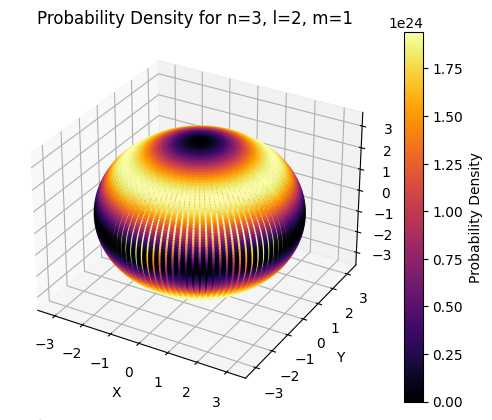

In [9]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.special import genlaguerre, sph_harm, factorial
from mpl_toolkits.mplot3d import Axes3D

# Constants
a_0 = 52.917721092 * 10**(-11)  # Bohr radius in meters

def R_nl(r, n, l):
    """Calculate the radial part of the wavefunction."""
    norm = np.sqrt((2/(n*a_0))**3 * factorial(n-l-1)/(2*n*factorial(n+l)))
    L = genlaguerre(n-l-1, 2*l+1)
    return norm * (2*r/n/a_0)**l * np.exp(-r/n/a_0) * L(2*r/n/a_0)

def plot_orbital(n, l, m):
    """Plot the probability density of the orbital specified by quantum numbers n, l, m."""
    theta, phi = np.mgrid[0:np.pi:100j, 0:2*np.pi:100j]
    r = np.linspace(0, 10*a_0, 200)
    R = np.array([R_nl(ri, n, l) for ri in r])
    Y = sph_harm(m, l, phi, theta)

    # Calculate the probability density
    psi = np.abs(R[:, None, None] * Y)**2

    # Integration for radial probability is removed to directly plot the 3D probability distribution
    # Convert to Cartesian coordinates for plotting
    x = np.sin(theta) * np.cos(phi)
    y = np.sin(theta) * np.sin(phi)
    z = np.cos(theta)

    # Broadcasting r to match x, y, z dimensions for volumetric plot
    r_broadcasted = r[:, None, None]
    x, y, z = [a * r_broadcasted for a in (x, y, z)]

    # Flatten for scatter plot and select a slice for clearer visualization
    slice_index = np.abs(psi).sum(axis=(1,2)).argmax()  # Index of r with max probability density
    x_slice, y_slice, z_slice = x[slice_index].flatten(), y[slice_index].flatten(), z[slice_index].flatten()
    psi_slice = psi[slice_index].flatten()

    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    scatter = ax.scatter(x_slice, y_slice, z_slice, c=psi_slice, cmap='inferno', marker='.')
    ax.set_title(f'Probability Density for n={n}, l={l}, m={m}')
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    plt.colorbar(scatter, ax=ax, label='Probability Density')
    plt.show()

# Example usage
plot_orbital(n=3, l=2, m=1)


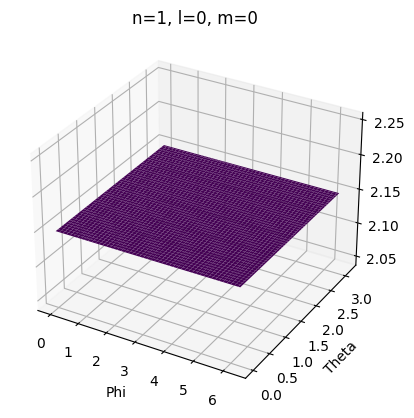

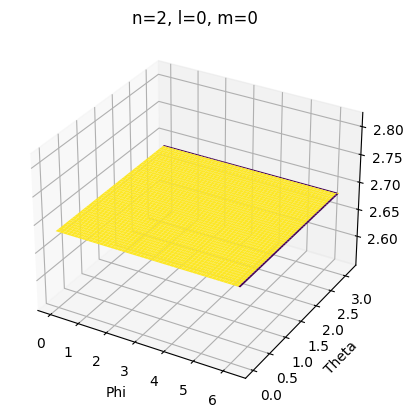

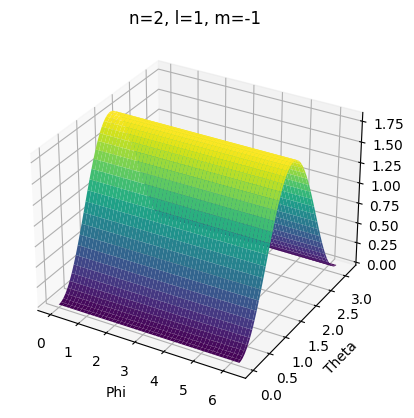

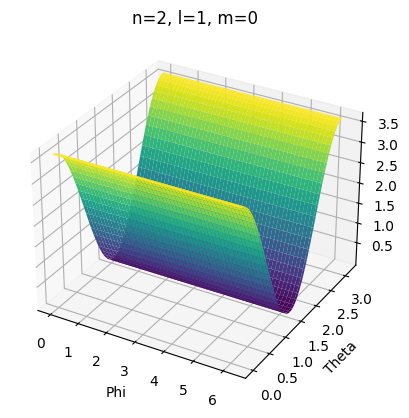

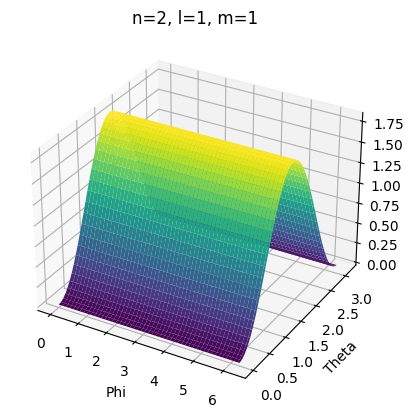

...

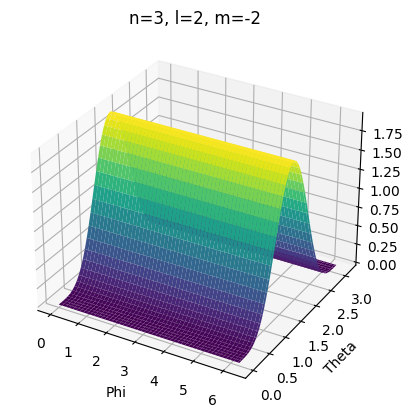

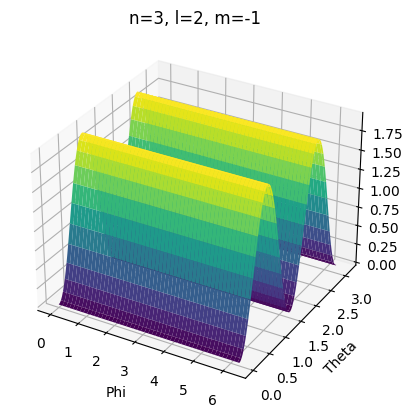

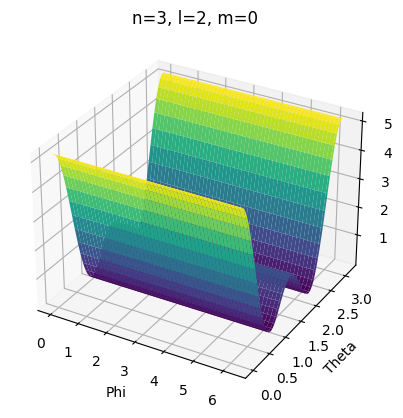

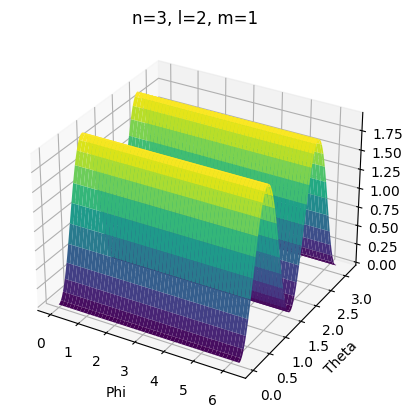

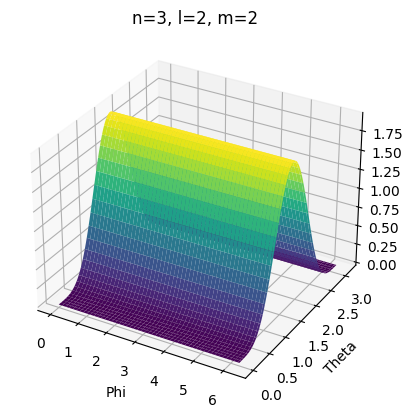

In [10]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.special import genlaguerre, sph_harm, factorial

# Constants
a_0 = 52.917721092 * 10**(-11)  # Bohr radius in meters

def R_nl(r, n, l):
    """Calculate the radial part of the wavefunction."""
    norm = np.sqrt((2/(n*a_0))**3 * factorial(n-l-1)/(2*n*factorial(n+l)))
    L = genlaguerre(n-l-1, 2*l+1)
    return norm * (2*r/n/a_0)**l * np.exp(-r/n/a_0) * L(2*r/n/a_0)

def plot_orbital(n, l, m):
    """Plot the probability density of the orbital specified by quantum numbers n, l, m."""
    theta, phi = np.mgrid[0:np.pi:100j, 0:2*np.pi:100j]
    r = np.linspace(0, 10*a_0, 200)
    R = np.array([R_nl(ri, n, l) for ri in r])
    Y = sph_harm(m, l, phi, theta)

    # Calculate the probability density
    psi = np.abs(R[:, None, None] * Y)**2

    # Broadcasting r to match dimensions for plotting
    r_broadcasted = r[:, None, None]
    psi_integral = np.trapz(np.trapz(psi, phi[0], axis=2), theta[:,0], axis=1)
    max_index = np.argmax(psi_integral)  # Index of max integrated probability
    psi_max_slice = psi[max_index, :, :]

    fig, ax = plt.subplots(subplot_kw={'projection': '3d'})
    # Plot a slice where the probability density is highest
    ax.plot_surface(phi, theta, psi_max_slice, cmap='viridis')
    ax.set_title(f'n={n}, l={l}, m={m}')
    ax.set_xlabel('Phi')
    ax.set_ylabel('Theta')
    plt.show()

# Loop over the quantum numbers
for n in range(1, 4):  # n from 1 to 3
    for l in range(0, n):
        for m in range(-l, l+1):
            plot_orbital(n, l, m)


IndexError: boolean index did not match indexed array along dimension 0; dimension is 200 but corresponding boolean dimension is 100

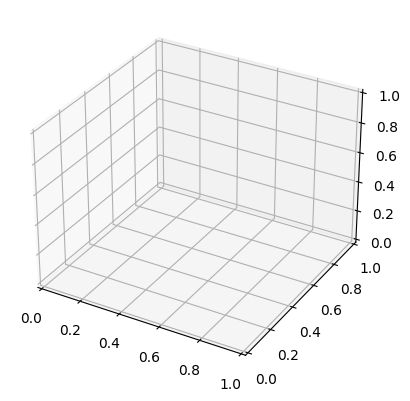

In [11]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.special import genlaguerre, sph_harm, factorial
from mpl_toolkits.mplot3d import Axes3D

# Constants
a_0 = 52.917721092 * 10**(-11)  # Bohr radius in meters

def R_nl(r, n, l):
    """Calculate the radial part of the wavefunction."""
    norm = np.sqrt((2/(n*a_0))**3 * factorial(n-l-1)/(2*n*factorial(n+l)))
    L = genlaguerre(n-l-1, 2*l+1)
    return norm * (2*r/n/a_0)**l * np.exp(-r/n/a_0) * L(2*r/n/a_0)

def plot_orbital(n, l, m):
    """Plot the probability density of the orbital specified by quantum numbers n, l, m."""
    # Meshgrid for spherical coordinates
    theta, phi = np.mgrid[0:np.pi:100j, 0:2*np.pi:100j]
    r = np.linspace(0, 10*a_0, 200)
    R = np.array([R_nl(ri, n, l) for ri in r])
    Y = sph_harm(m, l, phi, theta)

    # Calculate the probability density
    psi = np.abs(R[:, None, None] * Y)**2

    # Spherical to Cartesian conversion
    x = r[:, None, None] * np.sin(theta) * np.cos(phi)
    y = r[:, None, None] * np.sin(theta) * np.sin(phi)
    z = r[:, None, None] * np.cos(theta)

    # Summing over r to get a 2D projection
    psi_sum = np.sum(psi, axis=0)

    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    # Normalize psi for plotting
    psi_norm = psi_sum / np.max(psi_sum)

    # Plot only points with probability density above a threshold to avoid clutter
    threshold = 0.01
    ax.scatter(x[psi_norm > threshold], y[psi_norm > threshold], z[psi_norm > threshold], c=psi_norm[psi_norm > threshold], cmap='inferno', marker='.')
    ax.set_title(f'Orbital Visualization for n={n}, l={l}, m={m}')
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    plt.tight_layout()
    plt.show()

# Loop over the quantum numbers and plot
for n in range(1, 4):  # n from 1 to 3
    for l in range(0, n):
        for m in range(-l, l+1):
            plot_orbital(n, l, m)


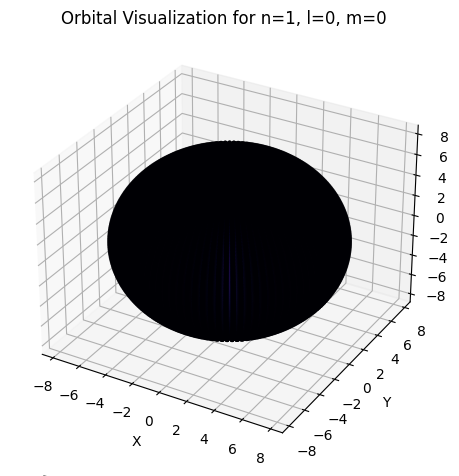

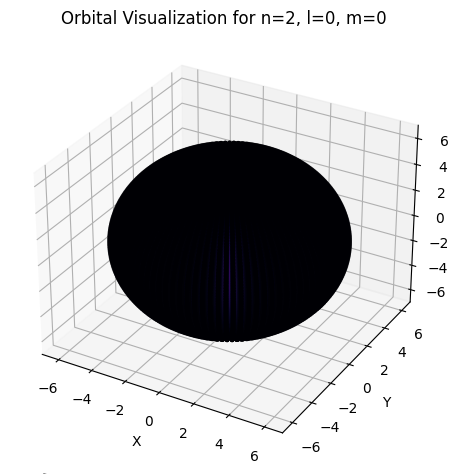

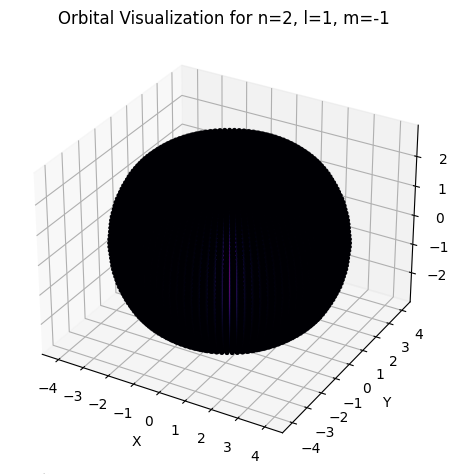

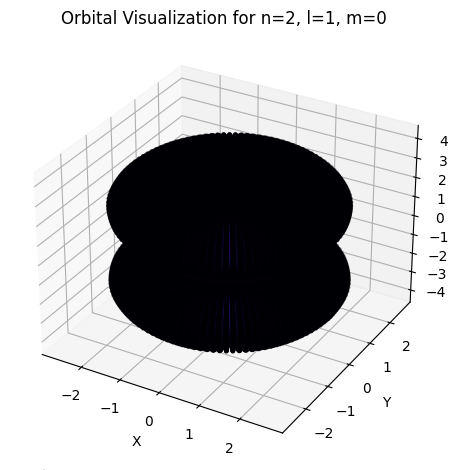

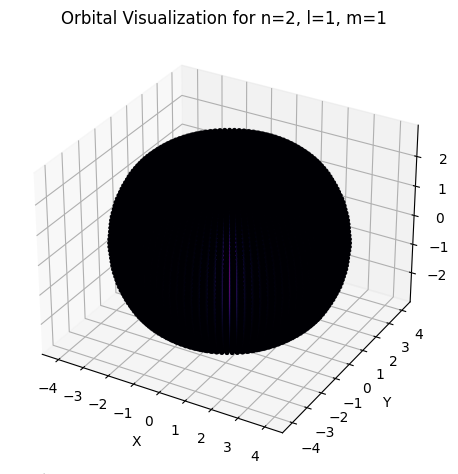

...

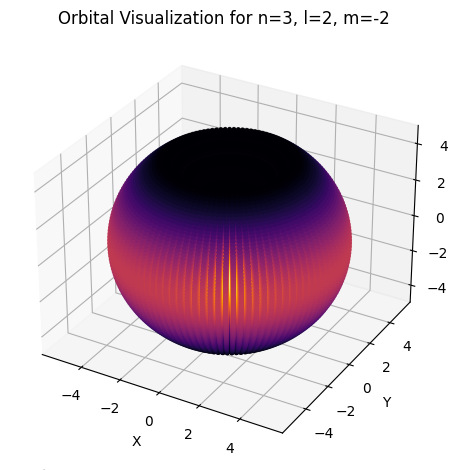

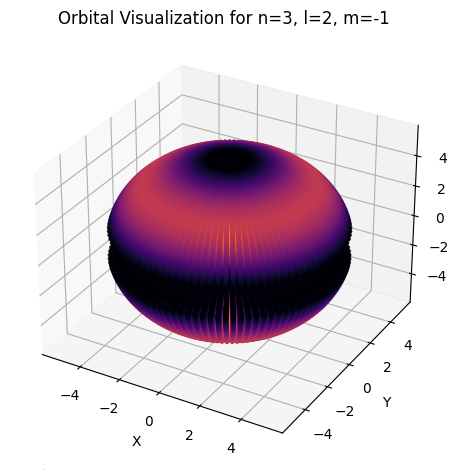

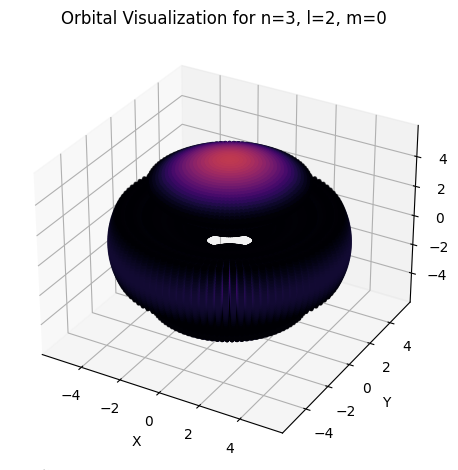

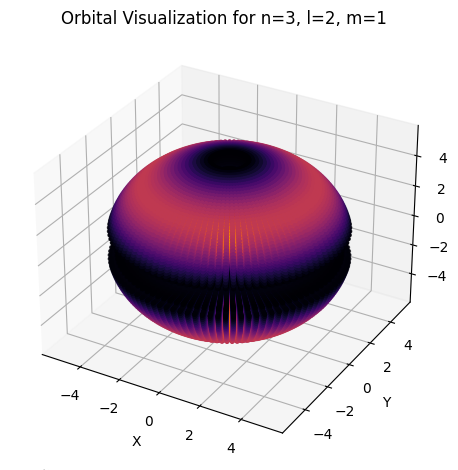

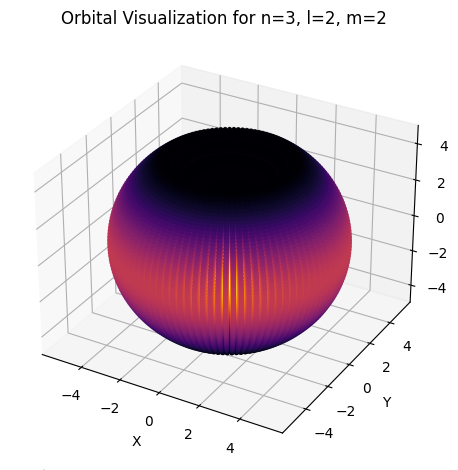

In [12]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.special import genlaguerre, sph_harm, factorial
from mpl_toolkits.mplot3d import Axes3D

# Constants
a_0 = 52.917721092 * 10**(-11)  # Bohr radius in meters

def R_nl(r, n, l):
    """Calculate the radial part of the wavefunction."""
    norm = np.sqrt((2/(n*a_0))**3 * factorial(n-l-1)/(2*n*factorial(n+l)))
    L = genlaguerre(n-l-1, 2*l+1)
    return norm * (2*r/n/a_0)**l * np.exp(-r/n/a_0) * L(2*r/n/a_0)

def plot_orbital(n, l, m):
    """Plot the probability density of the orbital specified by quantum numbers n, l, m."""
    # Meshgrid for spherical coordinates
    theta, phi = np.mgrid[0:np.pi:100j, 0:2*np.pi:100j]
    r = np.linspace(0, 10*a_0, 200)
    R = np.array([R_nl(ri, n, l) for ri in r])
    Y = sph_harm(m, l, phi, theta)

    # Calculate the probability density
    psi = np.abs(R[:, None, None] * Y)**2

    # Spherical to Cartesian conversion
    x = r[:, None, None] * np.sin(theta) * np.cos(phi)
    y = r[:, None, None] * np.sin(theta) * np.sin(phi)
    z = r[:, None, None] * np.cos(theta)

    # Flatten arrays for scatter plot
    x_flat = x.flatten()
    y_flat = y.flatten()
    z_flat = z.flatten()
    psi_flat = psi.flatten()

    # Apply threshold
    threshold = psi_flat.max() * 0.05  # Adjust threshold as needed
    mask = psi_flat > threshold

    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(x_flat[mask], y_flat[mask], z_flat[mask], c=psi_flat[mask], cmap='inferno', marker='.')
    ax.set_title(f'Orbital Visualization for n={n}, l={l}, m={m}')
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    plt.tight_layout()
    plt.show()

# Loop over the quantum numbers and plot
for n in range(1, 4):  # n from 1 to 3
    for l in range(0, n):
        for m in range(-l, l+1):
            plot_orbital(n, l, m)


In [13]:
import numpy as np
import plotly.graph_objects as go
from scipy.special import sph_harm

# Define a meshgrid for theta and phi
theta = np.linspace(0, np.pi, 100)
phi = np.linspace(0, 2 * np.pi, 100)
theta, phi = np.meshgrid(theta, phi)

# Quantum numbers for a p-orbital
n, l, m = 2, 1, 0

# Calculate the spherical harmonics
Y_lm = sph_harm(m, l, phi, theta)

# Calculate the magnitude squared of the spherical harmonics (probability density)
Y_lm_mag_squared = np.abs(Y_lm)**2

# Convert to Cartesian coordinates for plotting
x = np.sin(theta) * np.cos(phi) * Y_lm_mag_squared
y = np.sin(theta) * np.sin(phi) * Y_lm_mag_squared
z = np.cos(theta) * Y_lm_mag_squared

# Create a Plotly figure
fig = go.Figure(data=[go.Surface(x=x, y=y, z=z, surfacecolor=Y_lm_mag_squared)])

# Update layout for a better view
fig.update_layout(title=f'Probability Density for n={n}, l={l}, m={m} Orbital',
                  scene=dict(xaxis_title='X',
                             yaxis_title='Y',
                             zaxis_title='Z',
                             aspectmode='cube'),
                  autosize=False,
                  width=800, height=800)

# Show the plot
fig.show()


In [14]:
import numpy as np
import plotly.graph_objects as go
from scipy.special import sph_harm

def plot_orbital(n, l, m):
    # Meshgrid for theta and phi
    theta = np.linspace(0, np.pi, 100)
    phi = np.linspace(0, 2 * np.pi, 100)
    theta, phi = np.meshgrid(theta, phi)

    # Calculate spherical harmonics
    Y_lm = sph_harm(m, l, phi, theta)

    # Magnitude squared of the spherical harmonics
    Y_lm_mag_squared = np.abs(Y_lm)**2

    # Convert to Cartesian coordinates
    x = np.sin(theta) * np.cos(phi) * Y_lm_mag_squared
    y = np.sin(theta) * np.sin(phi) * Y_lm_mag_squared
    z = np.cos(theta) * Y_lm_mag_squared

    # Plotly figure
    fig = go.Figure(data=[go.Surface(x=x, y=y, z=z, surfacecolor=Y_lm_mag_squared)])

    # Update layout
    fig.update_layout(title=f'Probability Density for n={n}, l={l}, m={m} Orbital',
                      scene=dict(xaxis_title='X',
                                 yaxis_title='Y',
                                 zaxis_title='Z',
                                 aspectmode='cube'),
                      autosize=False,
                      width=600, height=600)

    # Show the plot
    fig.show()

# Loop over quantum numbers
for n in range(1, 4):  # Limit n to 3 for manageability
    for l in range(0, n):
        for m in range(-l, l+1):
            plot_orbital(n, l, m)


In [5]:
import numpy as np
import plotly.graph_objects as go
from scipy.special import sph_harm

def plot_orbital_with_opacity(n, l, m, opacity=0.5):
    # Meshgrid for theta and phi
    theta = np.linspace(0, np.pi, 100)
    phi = np.linspace(0, 2 * np.pi, 100)
    theta, phi = np.meshgrid(theta, phi)

    # Calculate spherical harmonics
    Y_lm = sph_harm(m, l, phi, theta)

    # Magnitude squared of the spherical harmonics
    Y_lm_mag_squared = np.abs(Y_lm)**2

    # Convert to Cartesian coordinates
    x = np.sin(theta) * np.cos(phi) * Y_lm_mag_squared
    y = np.sin(theta) * np.sin(phi) * Y_lm_mag_squared
    z = np.cos(theta) * Y_lm_mag_squared

    # Plotly figure
    fig = go.Figure(data=[go.Surface(x=x, y=y, z=z, surfacecolor=Y_lm_mag_squared, opacity=opacity)])

    # Update layout
    fig.update_layout(title=f'Probability Density for n={n}, l={l}, m={m} Orbital',
                      scene=dict(xaxis_title='X',
                                 yaxis_title='Y',
                                 zaxis_title='Z',
                                 aspectmode='cube'),
                      autosize=False,
                      width=600, height=600)

    # Show the plot
    fig.show()

# Example: Plotting with opacity
plot_orbital_with_opacity(n=2, l=1, m=0, opacity=0.5)

# Loop over quantum numbers
for n in range(1, 4):  # Limit n to 3 for manageability
    for l in range(0, n):
        for m in range(-l, l+1):
            plot_orbital_with_opacity(n, l, m, opacity=0.5 )
